# Analysis of DNA-MERFISH for CTP11-13

by Pu Zheng

2022.06.15

analysis for dataset:

dna_data_folder = r'\\10.245.74.158\Chromatin_NAS_5\20220419-P_brain_CTP11-13_from_0415storm65'

rna_data_folder = r'\\10.245.74.158\Chromatin_NAS_0\20220415-P_brain_M1_noclear_storm65'

save_folder = r'\\mendel\Mendel_SSD4\Pu_Temp\20220419-CTP11-13_from_0415storm65'

In [1]:
%run "..\..\Startup_py3.py"
sys.path.append(r"..\..\..\..\Documents")

import ImageAnalysis3 as ia
%matplotlib notebook

from ImageAnalysis3 import *
print(os.getpid())

import h5py
from ImageAnalysis3.classes import _allowed_kwds
import ast

39904


## 0.1 Folders

In [2]:
save_folder = r'\\mendel\Mendel_SSD4\Pu_Temp\20220419-CTP11-13_from_0415storm65'
save_filenames = [os.path.join(save_folder, _fl) for _fl in os.listdir(save_folder)
                  if _fl.split(os.extsep)[-1]=='hdf5']
# extract fov_id
save_fov_ids = [int(os.path.basename(_fl).split('.hdf5')[0].split('_')[-1]) for _fl in save_filenames]

debug = False

print(f"{len(save_filenames)} fovs detected")

segmentation_folder = os.path.join(save_folder, 'Segmentation')
if not os.path.exists(segmentation_folder):
    os.makedirs(segmentation_folder)
    print(f"Creating segmentation_folder: {segmentation_folder}")
else:
    print(f"Use segmentation_folder: {segmentation_folder}")

cand_spot_folder = os.path.join(save_folder, 'CandSpots')
if not os.path.exists(cand_spot_folder):
    os.makedirs(cand_spot_folder)
    print(f"Creating cand_spot_folder: {cand_spot_folder}")
else:
    print(f"Use cand_spot_folder: {cand_spot_folder}")

decoder_folder = cand_spot_folder.replace('CandSpots', 'Decoder')
if debug:
    _version = 0
    while os.path.exists(os.path.join(decoder_folder, f'v{_version}')):
        _version += 1
    decoder_folder = os.path.join(decoder_folder, f'v{_version}')
if not os.path.exists(decoder_folder):
    os.makedirs(decoder_folder)
    print(f"Creating decoder_folder: {decoder_folder}")
else:
    print(f"Use decoder_folder: {decoder_folder}")

picked_folder = os.path.join(save_folder, 'Picked_v0')
if not os.path.exists(picked_folder):
    os.makedirs(picked_folder)
    print(f"Creating picked_folder: {picked_folder}")
else:
    print(f"Use picked_folder: {picked_folder}")

217 fovs detected
Use segmentation_folder: \\mendel\Mendel_SSD4\Pu_Temp\20220419-CTP11-13_from_0415storm65\Segmentation
Use cand_spot_folder: \\mendel\Mendel_SSD4\Pu_Temp\20220419-CTP11-13_from_0415storm65\CandSpots
Use decoder_folder: \\mendel\Mendel_SSD4\Pu_Temp\20220419-CTP11-13_from_0415storm65\Decoder
Use picked_folder: \\mendel\Mendel_SSD4\Pu_Temp\20220419-CTP11-13_from_0415storm65\Picked_v0


In [13]:
import re
import multiprocessing as mp
from ImageAnalysis3.classes.decode import load_hdf5_dict
from ImageAnalysis3.classes.decode import DNA_Merfish_Decoder

picked_filenames = [os.path.join(picked_folder, _fl) for _fl in os.listdir(picked_folder) 
                     if re.search(r'Picked_fov-(?P<fovId>[0-9]+)_cell-(?P<cellId>[0-9]+).hdf5', _fl) is not None
                    ]
print(picked_folder, len(picked_filenames))

\\mendel\Mendel_SSD4\Pu_Temp\20220419-CTP11-13_from_0415storm65\Picked_v0 23547


In [55]:
picked_filenames[0]

'\\\\mendel\\Mendel_SSD4\\Pu_Temp\\20220419-CTP11-13_from_0415storm65\\Picked_v0\\Picked_fov-0_cell-1.hdf5'

In [3]:
pixel_sizes = np.array([250,108,108])
single_im_size = np.array([50,2048,2048])

## 0.2 Figure info

In [4]:
save_figure = True
#figure_folder = os.path.join(save_folder, 'Figures_final')
figure_folder = os.path.join(save_folder, 'Figures_0625')
if not os.path.exists(figure_folder):
    print(f"Create figure_folder: {figure_folder}")
    os.makedirs(figure_folder)
else:
    print(f"Use figure_folder: {figure_folder}")

Create figure_folder: \\mendel\Mendel_SSD4\Pu_Temp\20220419-CTP11-13_from_0415storm65\Figures_0625


## 0.3 Load Codebook

In [15]:
import pandas as pd

In [62]:
merged_codebook = pd.read_hdf( picked_filenames[0], 'picked/merged_codebook')

merged_codebook['id'] = merged_codebook.index

save_merged_codebook = os.path.join(decoder_folder, f"save_merged_codebook.csv")
print("Save merged_codebook:", save_merged_codebook)
merged_codebook.to_csv(save_merged_codebook, index=False)

Save merged_codebook: \\mendel\Mendel_SSD4\Pu_Temp\20220419-CTP11-13_from_0415storm65\Decoder\save_merged_codebook.csv


# 1. Load all [chr_2_hzxys_list] into cell types

## 1.1 Get dict for cell uid

In [5]:
%%time
fovcell_2_uid = {}

for _fov_id, _save_filename in zip(save_fov_ids, save_filenames):
    # segmentation filename
    _segmentation_savefile = os.path.join(segmentation_folder, 
        os.path.basename(_save_filename).replace('.hdf5', '_Segmentation.hdf5') )
    
    with h5py.File(_segmentation_savefile, 'r') as _f:
        for _fov_id in _f.keys():
            _fov_group = _f[_fov_id]
            _uid_group = _fov_group['cell_2_uid']
            for _cell_id in _uid_group.keys():
                fovcell_2_uid[(_fov_id, _cell_id)] = _uid_group[_cell_id][:][0].decode()
    print(_fov_id, len(fovcell_2_uid))

103
250
391
527
671
796
949
1090
1221
1333
1451
1576
1693
1814
1932
2050
2179
2321
2422
2532
2644
2754
2872
3004
3105
3203
3312
3414
3512
3612
3724
3840
3947
4065
4182
4302
4427
4561
4689
4819
4936
5041
5168
5244
5363
5453
5559
5666
5767
5862
5944
6010
6060
6099
6204
6328
6453
6569
6709
6825
6940
7072
7218
7352
7485
7589
7690
7798
7901
8009
8140
8274
8419
8541
8654
8746
8840
8948
9053
9183
9298
9394
9491
9617
9733
9837
9951
10074
10192
10313
10357
10441
10559
10671
10793
10905
11025
11153
11269
11366
11438
11478
11510
11589
11701
11823
11887
11910
11988
12049
12101
12145
12161
12219
12292
12371
12470
12590
12705
12823
13012
13158
13286
13408
13519
13636
13775
13907
14037
14174
14315
14453
14591
14707
14809
14919
15022
15121
15230
15329
15447
15552
15680
15800
15946
16083
16209
16336
16440
16547
16674
16814
16943
17069
17217
17350
17475
17585
17742
17907
18043
18194
18347
18396
18426
18445
18521
18625
18767
18908
19045
19154
19225
19249
19333
19424
19541
19674
19807
19934
20029
20153
20

## 1.2 cell type annotation

In [7]:
%%time
import scanpy as sc

# load cell type info
merfish_cluster_file = r'\\mendel\Mendel_SSD3\MERFISH_Analysis\Merged_MOP\manual_labeled_data.h5ad'

merfish_df = sc.read_h5ad(merfish_cluster_file)

Wall time: 297 ms


In [11]:
sel_exp = '20220415'
sel_obs = merfish_df.obs.loc[merfish_df.obs['experiment']==sel_exp]
uid_2_class = {_uid:_class for _uid, _class in zip(sel_obs.index, sel_obs['subclass_manual_label'])}

## 1.3 load chr_2_zxys_list

In [18]:
import re
import multiprocessing as mp
from ImageAnalysis3.classes.decode import load_hdf5_dict
from ImageAnalysis3.classes.decode import DNA_Merfish_Decoder

#decoder_folder = os.path.join(save_folder, 'Decoder')
picked_filenames = [os.path.join(picked_folder, _fl) for _fl in os.listdir(picked_folder) 
                     if re.search(r'Picked_fov-(?P<fovId>[0-9]+)_cell-(?P<cellId>[0-9]+).hdf5', _fl) is not None
                    ]
print(picked_folder, len(picked_filenames))

\\mendel\Mendel_SSD4\Pu_Temp\20220419-CTP11-13_from_0415storm65\Picked_v0 23547


In [19]:
%%time
print("Batch load chr_2_hzxys_list")
# Batch loading
load_args = [(_fl, 'picked/chr_2_filtered_hzxys_list') for _fl in picked_filenames]
print(len(load_args))
with mp.Pool(44) as load_pool:
    all_chr_2_hzxys_list = load_pool.starmap(load_hdf5_dict, 
                                            load_args, 
                                            chunksize=1)
    load_pool.close()
    load_pool.join()
    load_pool.terminate()

Batch load chr_2_hzxys_list
23547
Wall time: 51.2 s


In [20]:
uid_list = [fovcell_2_uid[
    re.findall(r'Picked_fov-(?P<fovId>[0-9]+)_cell-(?P<cellId>[0-9]+).hdf5', os.path.basename(_fl))[0]
           ] for _fl in picked_filenames]
len(uid_list)

23547

In [21]:
# convert into zxys
all_chr_2_zxys_list = []
for _chr_2_hzxys_list in all_chr_2_hzxys_list:
    all_chr_2_zxys_list.append( {_k:_v[:,:,1:] for _k,_v in _chr_2_hzxys_list.items()} )

## 2.4 split chr_2_hzxys into classes

In [23]:
class_2_chr_zxys = {}
for _class in np.unique(sel_obs['subclass_manual_label']):
    if _class not in class_2_chr_zxys:
        class_2_chr_zxys[_class] = []
    for _uid, _chr_zxys in zip(uid_list, all_chr_2_zxys_list):
        
        if _uid in uid_2_class and uid_2_class[_uid] == _class:
            class_2_chr_zxys[_class].append(_chr_zxys)
    print(_class, len(class_2_chr_zxys[_class]))      
class_2_chr_zxys = {_k:_v for _k,_v in class_2_chr_zxys.items() if len(_v)}
# save
save_class_2_chr_zxys = os.path.join(decoder_folder, f"class_2_chr_zxys_n{len(all_chr_2_zxys_list)}.pkl")
print("Save class_2_chr_zxys:", save_class_2_chr_zxys)
pickle.dump(class_2_chr_zxys, open(save_class_2_chr_zxys, 'wb'))

Astro 1738
Endo 1374
L2/3 IT 1662
L4/5 IT 1365
L5 ET 612
L5 IT 708
L5/6 NP 236
L6 CT 1730
L6 IT 944
L6b 427
Lamp5 215
Micro 550
OPC 490
Oligo 2570
Peri 385
Pvalb 521
SMC 279
Sncg 72
Sst 342
VLMC 320
Vip 171
other 13
Save class_2_chr_zxys: \\mendel\Mendel_SSD4\Pu_Temp\20220419-CTP11-13_from_0415storm65\Decoder\class_2_chr_zxys_n23547.pkl


## 2.5 summarize chr_zxys into classes

In [25]:
%%time
from ImageAnalysis3.structure_tools import distance
reload(distance)

min_class_num_cell = 50

class_2_summary_dict = {
    _class:distance.Chr2ZxysList_2_summaryDict(_chr_2_zxys_list, merged_codebook, num_threads=32, verbose=True) 
    for _class, _chr_2_zxys_list in class_2_chr_zxys.items() 
    if _class not in ['Other'] and len(_chr_2_zxys_list) > min_class_num_cell
}

-- preparing chr_2_zxys from 1738 cells in 0.140s.
-- summarize 231 inter-chr distances with 32 threads in 83.536s.
-- preparing chr_2_zxys from 1374 cells in 0.118s.
-- summarize 231 inter-chr distances with 32 threads in 62.484s.
-- preparing chr_2_zxys from 1662 cells in 0.135s.
-- summarize 231 inter-chr distances with 32 threads in 80.391s.
-- preparing chr_2_zxys from 1365 cells in 0.118s.
-- summarize 231 inter-chr distances with 32 threads in 64.330s.
-- preparing chr_2_zxys from 612 cells in 0.050s.
-- summarize 231 inter-chr distances with 32 threads in 34.618s.
-- preparing chr_2_zxys from 708 cells in 0.053s.
-- summarize 231 inter-chr distances with 32 threads in 37.641s.
-- preparing chr_2_zxys from 236 cells in 0.019s.
-- summarize 231 inter-chr distances with 32 threads in 24.146s.
-- preparing chr_2_zxys from 1730 cells in 0.157s.
-- summarize 231 inter-chr distances with 32 threads in 85.706s.
-- preparing chr_2_zxys from 944 cells in 0.073s.
-- summarize 231 inter-ch

# 3. Make plots

## 3.1 plot cell-type cis-trans

C:\Users\puzheng\AppData\Local\Temp/ipykernel_39904/1121241677.py:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(1, 2, figsize=(_single_im_size*2, _single_im_size*1.1), dpi=300, sharex=True, sharey=True)


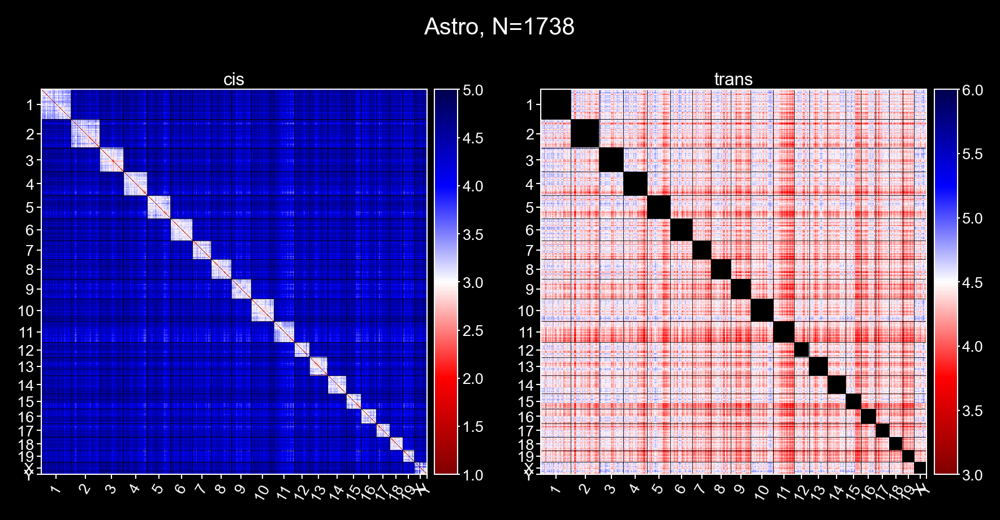

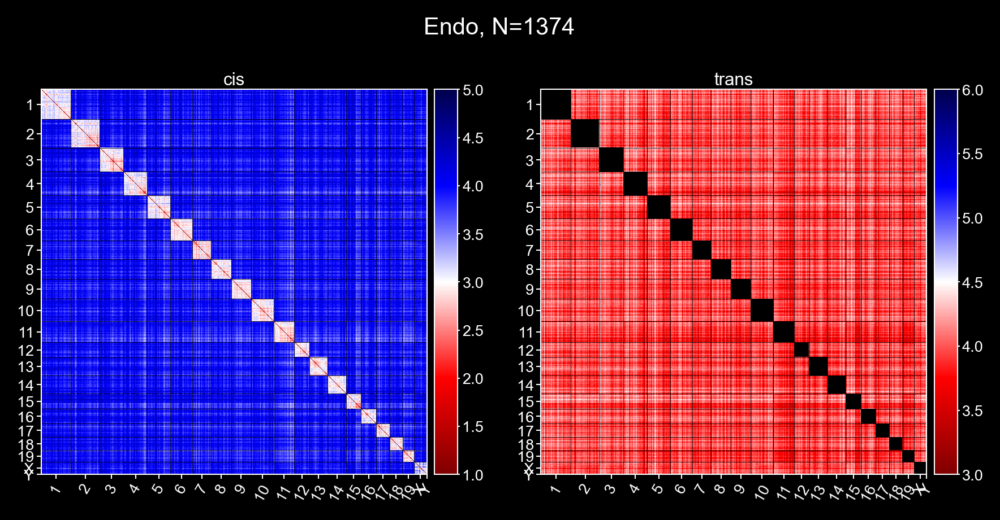

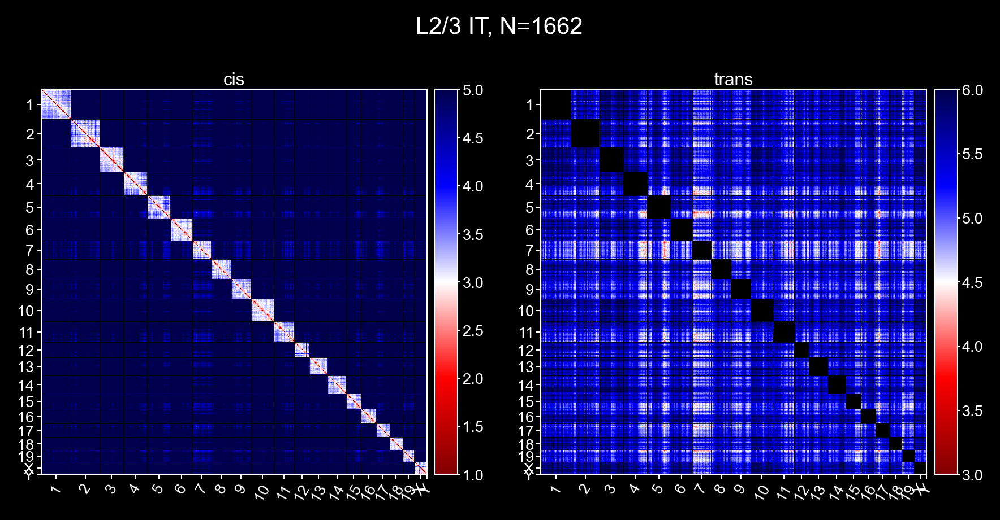

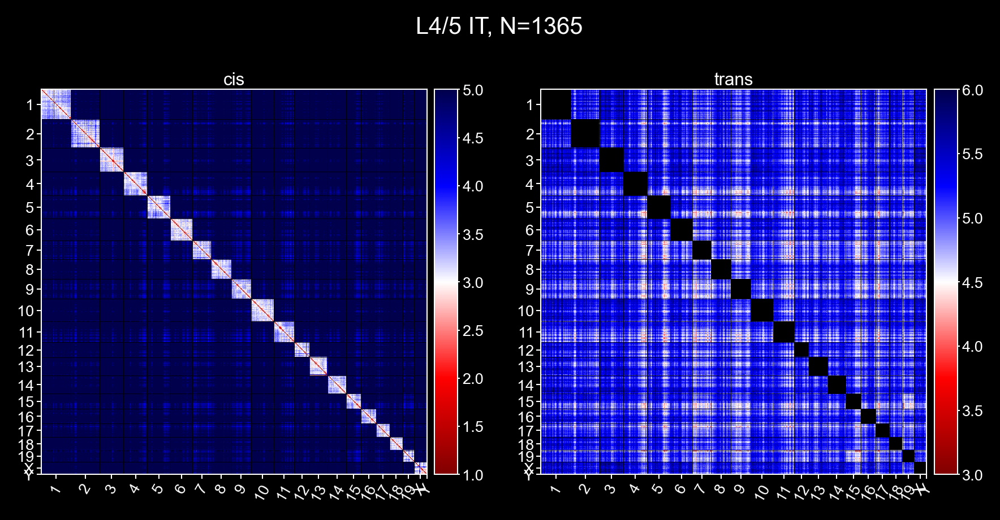

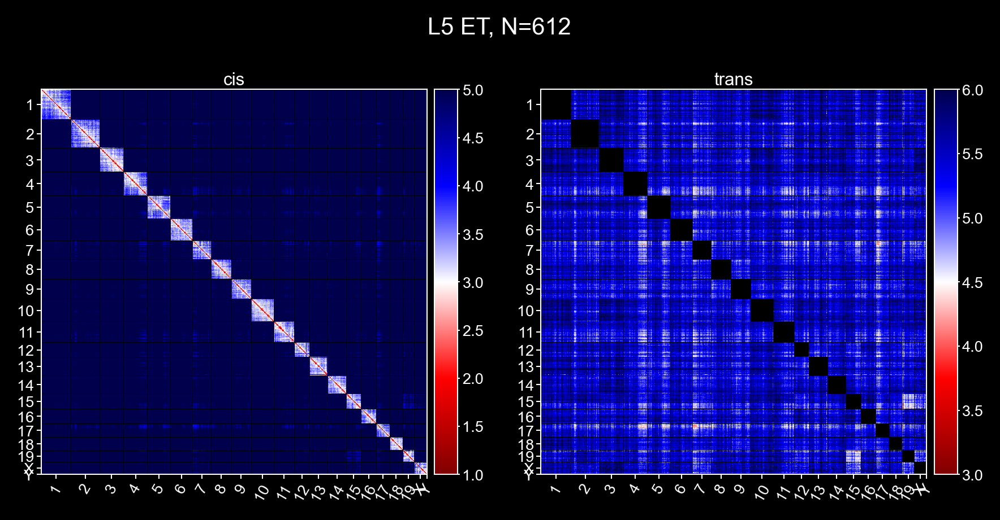

...

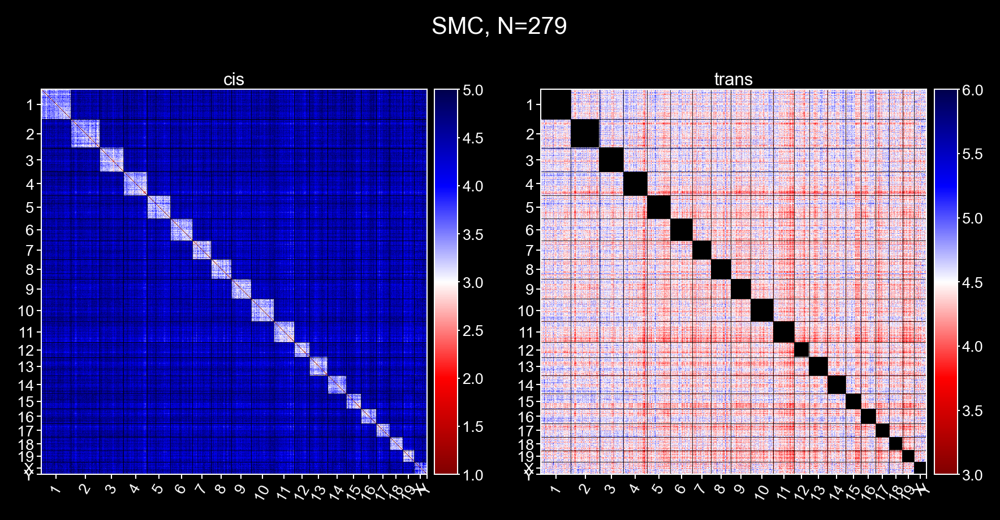

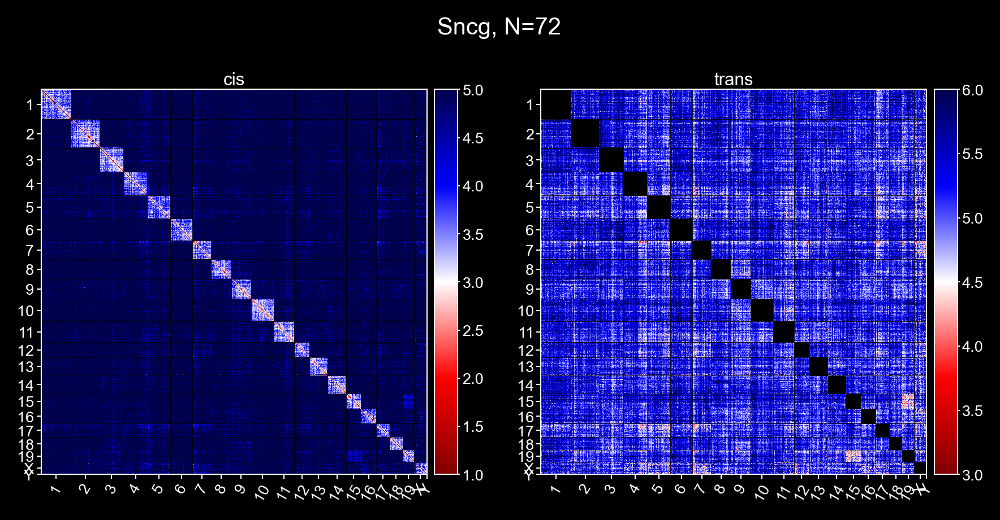

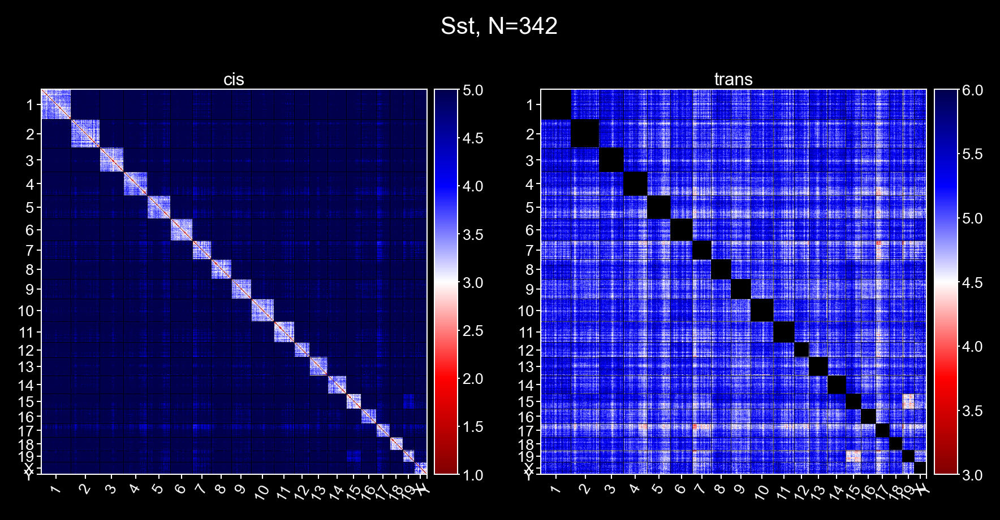

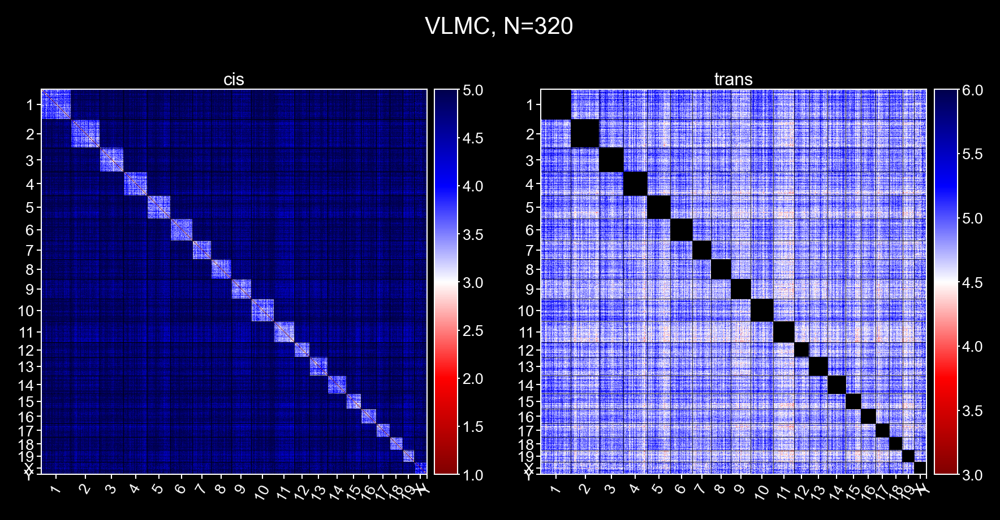

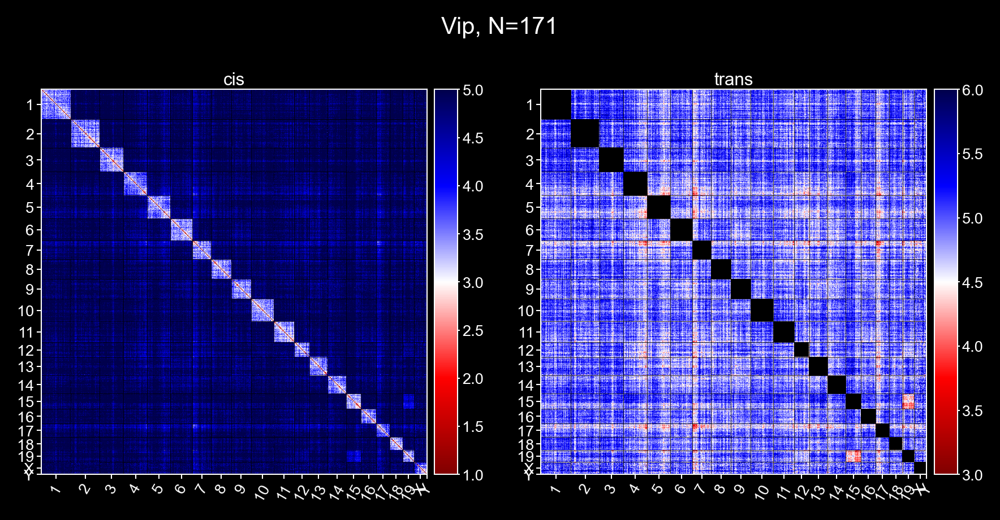

In [82]:
%matplotlib inline

plt.style.use('dark_background')
_single_im_size=3
sel_codebook = merged_codebook
sort_by_region = False

for _class, summary_dict in sorted(class_2_summary_dict.items() ):
    
    _cis_mat, chr_edges, chr_names = distance.assemble_ChrDistDict_2_Matrix(
        summary_dict, merged_codebook, 
        sel_codebook=sel_codebook, 
        use_cis=True, sort_by_region=sort_by_region,
    )
    _trans_mat, chr_edges, chr_names = distance.assemble_ChrDistDict_2_Matrix(
        summary_dict, merged_codebook, 
        sel_codebook=sel_codebook, 
        use_cis=False, sort_by_region=sort_by_region,
    )

    fig, axes = plt.subplots(1, 2, figsize=(_single_im_size*2, _single_im_size*1.1), dpi=300, sharex=True, sharey=True)

    ia.figure_tools.distmap.plot_distance_map(_cis_mat/1000, color_limits=[1,5],
                                              ax=axes[0], 
                                                ticks=(chr_edges[1:] + chr_edges[:-1])/2,
                                              tick_labels=chr_names,
                                              font_size=6.5)
    ia.figure_tools.distmap.plot_distance_map(_trans_mat/1000, color_limits=[3,6],
                                              ax=axes[1], 
                                              ticks=(chr_edges[1:] + chr_edges[:-1])/2,
                                              tick_labels=chr_names, 
                                              font_size=6.5)

    axes[0].set_title(f'cis', fontsize=7.5, pad=2)
    axes[1].set_title(f'trans', fontsize=7.5, pad=2)
    for _ax in axes:
        _ax.hlines(chr_edges-0.5, 0, len(_cis_mat), color='black', linewidth=0.2)
        _ax.vlines(chr_edges-0.5, 0, len(_cis_mat), color='black', linewidth=0.2)
        _ax.xaxis.set_tick_params(which='both', labelbottom=True)
        _ax.yaxis.set_tick_params(which='both', labelleft=True)
    
    fig.subplots_adjust(wspace=0.2, hspace=0.2, left=0.05, right=0.95, top=0.97, bottom=0.02)
    fig.suptitle(f"{_class}, N={len(class_2_chr_zxys[_class])}", fontsize=10, y=0.97)
    fig.savefig(os.path.join(figure_folder, f"cis-trans-median_distmap_byreg_{_class.replace('/','_')}.png"))
    #fig.show()

## 3.2 plot cis for all types

In [76]:
visualize_chr = True

sort_by_region = False

chr_2_indices, chr_2_orders = distance.Generate_PlotOrder(merged_codebook, merged_codebook, sort_by_region=sort_by_region)


C:\Users\puzheng\AppData\Local\Temp/ipykernel_39904/616695334.py:41: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "tranparent" which is no longer supported as of 3.3 and will become an error two minor releases later
  fig.savefig(os.path.join(figure_folder, f"all_type_cis_median_distmap_chr-{sel_chr}.png"),
C:\Users\puzheng\AppData\Local\Temp/ipykernel_39904/616695334.py:47: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig.show()


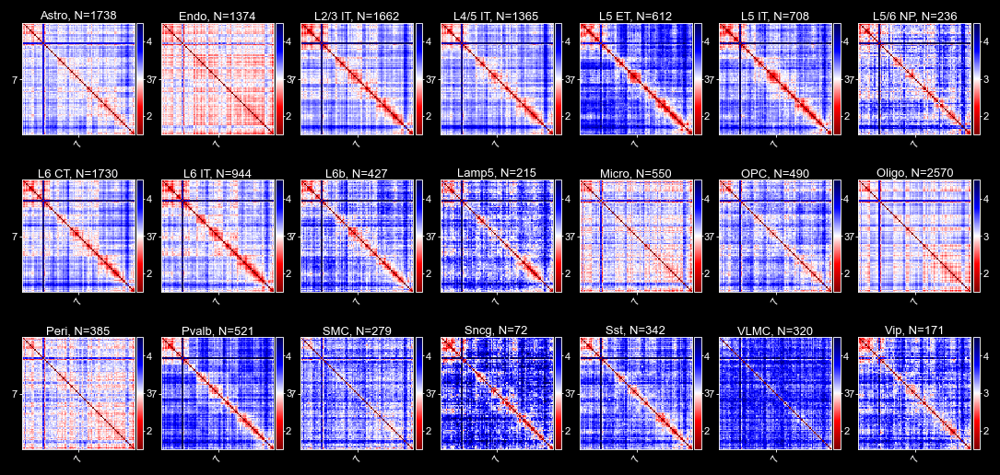

In [79]:
#%matplotlib inline
_single_im_size=1.25
_num_cols = 7
_num_rows =  int(np.ceil(len(class_2_summary_dict)/_num_cols))
fig, axes_list = plt.subplots(_num_rows, _num_cols, 
                              figsize=(_single_im_size*_num_cols, _single_im_size*_num_rows*1.1), 
                              dpi=125,
                              sharex=True, sharey=True)
class_names = sorted(list(class_2_summary_dict.keys()))
_plot_id = 0
for _row_axes in axes_list:
    for _ax in _row_axes:
        if _plot_id >= len(class_names):
            continue
        _cis_mat, chr_edges, chr_names = distance.assemble_ChrDistDict_2_Matrix(class_2_summary_dict[class_names[_plot_id]], 
                                                          merged_codebook, use_cis=True, sort_by_region=sort_by_region)
        _ax = ia.figure_tools.distmap.plot_distance_map(
            _cis_mat/1000, color_limits=[1.5, 4.5],
            ticks=(chr_edges[1:] + chr_edges[:-1])/2,
            tick_labels=chr_names,
            font_size=6.5,
            ax=_ax,)
        _ax.set_title(f"{class_names[_plot_id]}, N={len(class_2_chr_zxys[class_names[_plot_id]])}", 
                      fontsize=7.5, pad=2)
        _ax.hlines(chr_edges, 0, len(_cis_mat), color='black', linewidth=0.25)
        _ax.vlines(chr_edges, 0, len(_cis_mat), color='black', linewidth=0.25)
        _ax.xaxis.set_tick_params(which='both', labelbottom=True)
        _ax.yaxis.set_tick_params(which='both', labelleft=True)
        # next plot
        _plot_id += 1
        
fig.subplots_adjust(wspace=0.15, hspace=0.15, left=0.02, right=0.97, top=0.97, bottom=0.02)


if visualize_chr:
    sel_chr = '7'
    #for sel_chr in chr_2_indices:
    sel_chr_inds = chr_2_indices[sel_chr]
    _ax.set_xlim([min(sel_chr_inds), max(sel_chr_inds)])
    _ax.set_ylim([ max(sel_chr_inds), min(sel_chr_inds)])
    fig.savefig(os.path.join(figure_folder, f"all_type_cis_median_distmap_chr-{sel_chr}.png"),
                tranparent=True)
    
else:
    fig.savefig(os.path.join(figure_folder, f"all_type_cis_median_distmap.png"),
                tranparent=True)
fig.show()

## 3.3 Loss-rates

In [65]:
chr_2_indices

{'1': array([  0,   1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,
         13,  14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,  25,
         26,  27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,  38,
         39,  40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50,  51,
         52,  53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,  64,
         65,  66,  67,  68,  69,  70,  71,  72,  73,  74,  75,  76,  77,
         78,  79,  80,  81,  82,  83,  84,  85,  86,  87,  88,  89,  90,
         91,  92,  93,  94,  95,  96,  97,  98,  99, 100, 101, 102, 103,
        104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116,
        117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129,
        130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142,
        143, 144, 145, 146, 147, 148, 149, 150, 151, 152]),
 '2': array([153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165,
        166, 167, 168, 169, 170, 171, 172, 173, 174, 1

In [66]:
from ImageAnalysis3.structure_tools import distance
sel_codebook = merged_codebook
sort_by_region = True

chr_2_indices, chr_2_orders = distance.Generate_PlotOrder(merged_codebook, sel_codebook, sort_by_region=sort_by_region)
chr_edges, chr_names = distance.generate_plot_chr_edges(sel_codebook, chr_2_indices, sort_by_region=sort_by_region)

In [67]:
chr_2_loss_rates = {}
for _chr in np.unique(sel_codebook['chr']):
    print(_chr)
    _chr_zxys = [_d.get(_chr) for _d in all_chr_2_zxys_list if _chr in _d and len(_d.get(_chr)) > 0]
    if len(_chr_zxys) > 0:
        _chr_zxys = np.concatenate(_chr_zxys)
        chr_2_loss_rates[_chr] = np.isnan(_chr_zxys).any(2).mean(axis=0)

1
10
11
12
13
14
15
16
17
18
19
2
3
4
5
6
7
8
9
X
Y


In [72]:
chr_2_orders

{'1': array([  0.,   1.,   2.,   5.,   6.,   7.,   8.,  10.,  14.,  17.,  18.,
         19.,  20.,  23.,  25.,  28.,  30.,  32.,  33.,  35.,  38.,  43.,
         47.,  50.,  52.,  53.,  56.,  57.,  61.,  64.,  65.,  67.,  71.,
         73.,  75.,  77.,  80.,  81.,  83.,  84.,  85.,  87.,  88.,  89.,
         90.,  92.,  93.,  96.,  98., 100., 101., 102., 103., 104., 106.,
        108., 109., 111., 112., 114., 116., 118., 119., 120., 124., 125.,
        128., 130., 134., 135., 137., 139., 141., 142., 145., 150., 152.,
          3.,   4.,   9.,  11.,  12.,  13.,  15.,  16.,  21.,  22.,  24.,
         26.,  27.,  29.,  31.,  34.,  36.,  37.,  39.,  40.,  41.,  42.,
         44.,  45.,  46.,  48.,  49.,  51.,  54.,  55.,  58.,  59.,  60.,
         62.,  63.,  66.,  68.,  69.,  70.,  72.,  74.,  76.,  78.,  79.,
         82.,  86.,  91.,  94.,  95.,  97.,  99., 105., 107., 110., 113.,
        115., 117., 121., 122., 123., 126., 127., 129., 131., 132., 133.,
        136., 138., 140., 143., 1

In [73]:
# get losss-rate vector
loss_rates = np.ones(len(sel_codebook)) * np.nan
for _chr, _rates in chr_2_loss_rates.items():
    loss_rates[chr_2_indices[_chr]] = _rates[chr_2_orders[_chr].astype(np.int32)]

C:\Users\puzheng\AppData\Local\Temp/ipykernel_39904/665003422.py:15: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "tranparent" which is no longer supported as of 3.3 and will become an error two minor releases later
  fig.savefig(os.path.join(figure_folder, f"loss_rates_by_region.png"),
C:\Users\puzheng\AppData\Local\Temp/ipykernel_39904/665003422.py:17: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig.show()


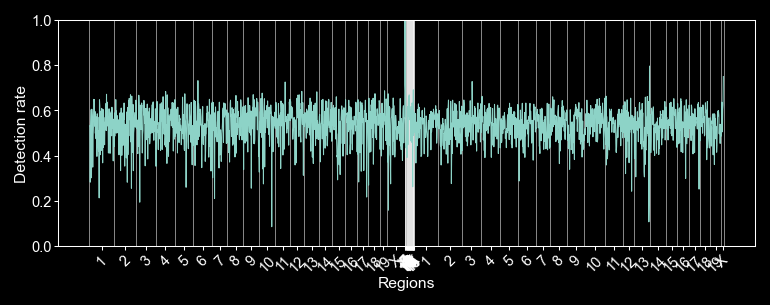

In [75]:
fig, ax = plt.subplots(figsize=(6,2),dpi=150)
_l = ax.plot(1-loss_rates, linewidth=0.5)
ax.set_ylim([0,1])
ax.set_xlabel('Regions', labelpad=1, fontsize=7.5)
ax.set_ylabel('Detection rate', labelpad=1, fontsize=7.5)
# border
[i[1].set_linewidth(0.5) for i in ax.spines.items()]
# ticks
ax.tick_params('both', labelsize=7, 
               width=0.5, length=2,
               pad=1)
ax.vlines(chr_edges-0.5, 0, 1, linewidth=0.25)
ax.set_xticks((chr_edges[1:] + chr_edges[:-1])/2)
ax.set_xticklabels(chr_names, rotation=45)
fig.savefig(os.path.join(figure_folder, f"loss_rates_by_region.png"),
            tranparent=True)
fig.show()